# Detecting Natural Disasters with Keras and Deep Learning

### Downloading the dataset

In [2]:
!wget https://pis-datasets.s3.us-east-2.amazonaws.com/Cyclone_Wildfire_Flood_Earthquake_Database.zip
!unzip -qq Cyclone_Wildfire_Flood_Earthquake_Database.zip

--2021-06-18 19:08:16--  https://pis-datasets.s3.us-east-2.amazonaws.com/Cyclone_Wildfire_Flood_Earthquake_Database.zip
Resolving pis-datasets.s3.us-east-2.amazonaws.com (pis-datasets.s3.us-east-2.amazonaws.com)... 52.219.101.114
Connecting to pis-datasets.s3.us-east-2.amazonaws.com (pis-datasets.s3.us-east-2.amazonaws.com)|52.219.101.114|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1901397543 (1.8G) [application/zip]
Saving to: ‘Cyclone_Wildfire_Flood_Earthquake_Database.zip’

Cyclone_Wildfire_Fl 100%[===================>]   1.77G   121MB/s    in 23s     

2021-06-18 19:08:40 (79.1 MB/s) - ‘Cyclone_Wildfire_Flood_Earthquake_Database.zip’ saved [1901397543/1901397543]



### Import Packages

In [3]:
# import the necessary packages
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import SGD
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from pyimagesearch.learningratefinder import LearningRateFinder
from pyimagesearch.clr_callback import CyclicLR
from tensorflow.keras.models import load_model
from collections import deque
from imutils import paths
import matplotlib.pyplot as plt
import numpy as np
import argparse
import pickle
import cv2
import sys
import os

### Our configuration class

In [4]:
class Config:
    # initialize the path to the input directory containing our dataset
    # of images
    DATASET_PATH = "Cyclone_Wildfire_Flood_Earthquake_Database"
    
    # initialize the class labels in the dataset
    CLASSES = ["Cyclone", "Earthquake", "Flood", "Wildfire"]

    # define the size of the training, validation (which comes from the
    # train split), and testing splits, respectively
    TRAIN_SPLIT = 0.75
    VAL_SPLIT = 0.1
    TEST_SPLIT = 0.25

    # define the minimum learning rate, maximum learning rate, batch size,
    # step size, CLR method, and number of epochs
    MIN_LR = 1e-6
    MAX_LR = 1e-4
    BATCH_SIZE = 32
    STEP_SIZE = 8
    CLR_METHOD = "triangular"
    NUM_EPOCHS = 48

    # set the path to the serialized model after training
    MODEL_PATH = os.path.sep.join(["output", "natural_disaster.model"])
    
    # define the path to the output learning rate finder plot, training
    # history plot and cyclical learning rate plot
    LRFIND_PLOT_PATH = os.path.sep.join(["output", "lrfind_plot.png"])
    TRAINING_PLOT_PATH = os.path.sep.join(["output", "training_plot.png"])
    CLR_PLOT_PATH = os.path.sep.join(["output", "clr_plot.png"])

# initialize our configuration instance
config = Config()

### Implementing our training script with Keras

In [5]:
# since we are using Jupyter Notebooks we can replace our argument
# parsing code with *hard coded* arguments and values
args = {
   "lr_find": 0
}

In [6]:
# grab the paths to all images in our dataset directory and initialize
# our lists of images and class labels
print("[INFO] loading images...")
imagePaths = list(paths.list_images(config.DATASET_PATH))
data = []
labels = []

[INFO] loading images...


In [7]:
# loop over the image paths
for imagePath in imagePaths:
	# extract the class label
	label = imagePath.split(os.path.sep)[-2]
	
    # load the image, convert it to RGB channel ordering, and resize
	# it to be a fixed 224x224 pixels, ignoring aspect ratio
	image = cv2.imread(imagePath)
	image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
	image = cv2.resize(image, (224, 224))
	
    # update the data and labels lists, respectively
	data.append(image)
	labels.append(label)

# convert the data and labels to NumPy arrays
print("[INFO] processing data...")
data = np.array(data, dtype="float32")
labels = np.array(labels)
 
# perform one-hot encoding on the labels
lb = LabelBinarizer()
labels = lb.fit_transform(labels)

[INFO] processing data...


In [8]:
# partition the data into training and testing splits
(trainX, testX, trainY, testY) = train_test_split(data, labels,
	test_size=config.TEST_SPLIT, random_state=42)

# take the validation split from the training split
(trainX, valX, trainY, valY) = train_test_split(trainX, trainY,
	test_size=config.VAL_SPLIT, random_state=84)

# initialize the training data augmentation object
aug = ImageDataGenerator(
	rotation_range=30,
	zoom_range=0.15,
	width_shift_range=0.2,
	height_shift_range=0.2,
	shear_range=0.15,
	horizontal_flip=True,
	fill_mode="nearest")

In [9]:
# load the VGG16 network, ensuring the head FC layer sets are left
# off
baseModel = VGG16(weights="imagenet", include_top=False,
	input_tensor=Input(shape=(224, 224, 3)))

# construct the head of the model that will be placed on top of the
# the base model
headModel = baseModel.output
headModel = Flatten(name="flatten")(headModel)
headModel = Dense(512, activation="relu")(headModel)
headModel = Dropout(0.5)(headModel)
headModel = Dense(len(config.CLASSES), activation="softmax")(headModel)

# place the head FC model on top of the base model (this will become
# the actual model we will train)
model = Model(inputs=baseModel.input, outputs=headModel)

# loop over all layers in the base model and freeze them so they will
# *not* be updated during the first training process
for layer in baseModel.layers:
	layer.trainable = False

# compile our model (this needs to be done after our setting our
# layers to being non-trainable
print("[INFO] compiling model...")
opt = SGD(lr=config.MIN_LR, momentum=0.9)
model.compile(loss="categorical_crossentropy", optimizer=opt,
	metrics=["accuracy"])

58892288/58889256 [==============================] - 0s 0us/step
[INFO] compiling model...


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/optimizer_v2/optimizer_v2.py:375: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")


In [10]:
# check to see if we are attempting to find an optimal learning rate
# before training for the full number of epochs
if args["lr_find"] > 0:
	# initialize the learning rate finder and then train with learning
	# rates ranging from 1e-10 to 1e+1
	print("[INFO] finding learning rate...")
	lrf = LearningRateFinder(model)
	lrf.find(
		aug.flow(trainX, trainY, batch_size=config.BATCH_SIZE),
		1e-10, 1e+1,
		stepsPerEpoch=np.ceil((trainX.shape[0] / float(config.BATCH_SIZE))),
		epochs=20,
		batchSize=config.BATCH_SIZE)
 
	# plot the loss for the various learning rates and save the
	# resulting plot to disk
	lrf.plot_loss()
	plt.savefig(config.LRFIND_PLOT_PATH)
 
	# gracefully exit the script so we can adjust our learning rates
	# in the config and then train the network for our full set of
	# epochs
	print("[INFO] learning rate finder complete")
	print("[INFO] examine plot and adjust learning rates before training")

In [11]:
# otherwise, we have already defined a learning rate space to train
# over, so compute the step size and initialize the cyclic learning
# rate method
stepSize = config.STEP_SIZE * (trainX.shape[0] // config.BATCH_SIZE)
clr = CyclicLR(
	mode=config.CLR_METHOD,
	base_lr=config.MIN_LR,
	max_lr=config.MAX_LR,
	step_size=stepSize)

# train the network
print("[INFO] training network...")
H = model.fit_generator(
	aug.flow(trainX, trainY, batch_size=config.BATCH_SIZE),
	validation_data=(valX, valY),
	steps_per_epoch=trainX.shape[0] // config.BATCH_SIZE,
	epochs=config.NUM_EPOCHS,
	callbacks=[clr],
	verbose=1)

[INFO] training network...


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:1940: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/48
93/93 [==============================] - 71s 383ms/step - loss: 10.4308 - accuracy: 0.4104 - val_loss: 1.7952 - val_accuracy: 0.7748
Epoch 2/48
93/93 [==============================] - 30s 326ms/step - loss: 3.5188 - accuracy: 0.6972 - val_loss: 0.9577 - val_accuracy: 0.8799
Epoch 3/48
93/93 [==============================] - 31s 327ms/step - loss: 2.2089 - accuracy: 0.7771 - val_loss: 0.7144 - val_accuracy: 0.9069
Epoch 4/48
93/93 [==============================] - 31s 327ms/step - loss: 1.6445 - accuracy: 0.8055 - val_loss: 0.5898 - val_accuracy: 0.9009
Epoch 5/48
93/93 [==============================] - 31s 327ms/step - loss: 1.2217 - accuracy: 0.8136 - val_loss: 0.4673 - val_accuracy: 0.9159
Epoch 6/48
93/93 [==============================] - 31s 327ms/step - loss: 0.8673 - accuracy: 0.8488 - val_loss: 0.4183 - val_accuracy: 0.9219
Epoch 7/48
93/93 [==============================] - 30s 327ms/step - loss: 0.7767 - accuracy: 0.8447 - val_loss: 0.4211 - val_accuracy: 0.918

In [12]:
# evaluate the network and show a classification report
print("[INFO] evaluating network...")
predictions = model.predict(testX, batch_size=config.BATCH_SIZE)
print(classification_report(testY.argmax(axis=1),
	predictions.argmax(axis=1), target_names=config.CLASSES))

# serialize the model to disk
print("[INFO] serializing network to '{}'...".format(config.MODEL_PATH))
model.save(config.MODEL_PATH)

[INFO] evaluating network...
              precision    recall  f1-score   support

     Cyclone       0.97      0.98      0.97       249
  Earthquake       0.94      0.94      0.94       316
       Flood       0.94      0.94      0.94       279
    Wildfire       0.96      0.96      0.96       263

    accuracy                           0.95      1107
   macro avg       0.95      0.95      0.95      1107
weighted avg       0.95      0.95      0.95      1107

[INFO] serializing network to 'output/natural_disaster.model'...
INFO:tensorflow:Assets written to: output/natural_disaster.model/assets


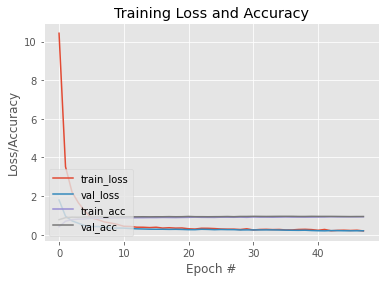

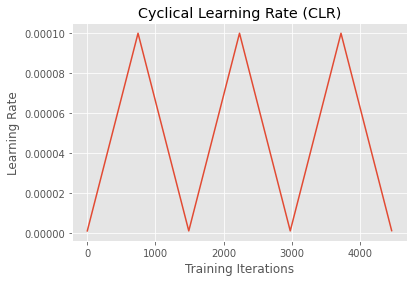

In [13]:
# construct a plot that plots and saves the training history
N = np.arange(0, config.NUM_EPOCHS)
plt.style.use("ggplot")
plt.figure()
plt.plot(N, H.history["loss"], label="train_loss")
plt.plot(N, H.history["val_loss"], label="val_loss")
plt.plot(N, H.history["accuracy"], label="train_acc")
plt.plot(N, H.history["val_accuracy"], label="val_acc")
plt.title("Training Loss and Accuracy")
plt.xlabel("Epoch #")
plt.ylabel("Loss/Accuracy")
plt.legend(loc="lower left")
plt.savefig(config.TRAINING_PLOT_PATH)

# plot the learning rate history
N = np.arange(0, len(clr.history["lr"]))
plt.figure()
plt.plot(N, clr.history["lr"])
plt.title("Cyclical Learning Rate (CLR)")
plt.xlabel("Training Iterations")
plt.ylabel("Learning Rate")
plt.savefig(config.CLR_PLOT_PATH)

### Implementing our natural disaster prediction script

In [14]:
# since we are using Jupyter Notebooks we can replace our argument
# parsing code with *hard coded* arguments and values
args = {
   "input": "videos/floods_101_nat_geo.mp4",
   "output": "output/floods_101_nat_geo.avi",
   "size": 128,
   "display": -1
}

In [15]:
# load the trained model from disk
print("[INFO] loading model and label binarizer...")
model = load_model(config.MODEL_PATH)

# initialize the predictions queue
Q = deque(maxlen=args["size"])

# initialize the video stream, pointer to output video file, and
# frame dimensions
print("[INFO] processing video...")
vs = cv2.VideoCapture(args["input"])
writer = None
(W, H) = (None, None)

[INFO] loading model and label binarizer...
[INFO] processing video...


In [16]:
# loop over frames from the video file stream
while True:
	# read the next frame from the file
	(grabbed, frame) = vs.read()
 
	# if the frame was not grabbed, then we have reached the end
	# of the stream
	if not grabbed:
		break
 
	# if the frame dimensions are empty, grab them
	if W is None or H is None:
		(H, W) = frame.shape[:2]

	# clone the output frame, then convert it from BGR to RGB
	# ordering and resize the frame to a fixed 224x224
	output = frame.copy()
	frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
	frame = cv2.resize(frame, (224, 224))
	frame = frame.astype("float32")
	
	# make predictions on the frame and then update the predictions
	# queue
	preds = model.predict(np.expand_dims(frame, axis=0))[0]
	Q.append(preds)

	# perform prediction averaging over the current history of
	# previous predictions
	results = np.array(Q).mean(axis=0)
	i = np.argmax(results)
	label = config.CLASSES[i]

	# draw the activity on the output frame
	text = "activity: {}".format(label)
	cv2.putText(output, text, (35, 50), cv2.FONT_HERSHEY_SIMPLEX,
		1.25, (0, 255, 0), 5)
 
	# check if the video writer is None
	if writer is None:
		# initialize our video writer
		fourcc = cv2.VideoWriter_fourcc(*"MJPG")
		writer = cv2.VideoWriter(args["output"], fourcc, 30,
			(W, H), True)
 
	# write the output frame to disk
	writer.write(output)
 
	# check to see if we should display the output frame to our
	# screen
	if args["display"] > 0:
		# show the output image
		cv2.imshow("Output", output)
		key = cv2.waitKey(1) & 0xFF
	 
		# if the `q` key was pressed, break from the loop
		if key == ord("q"):
			break
 
# release the file pointers
print("[INFO] cleaning up...")
writer.release()
vs.release()

[INFO] cleaning up...


The above code block takes a while to complete its execution. 

Our output video is produced in `.avi` format. First, we need to convert it to `.mp4` format. 

In [17]:
!ffmpeg -i "output/floods_101_nat_geo.avi" output.mp4

ffmpeg version 3.4.8-0ubuntu0.2 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 7 (Ubuntu 7.5.0-3ubuntu1~18.04)
  configuration: --prefix=/usr --extra-version=0ubuntu0.2 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --enable-gpl --disable-stripping --enable-avresample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librubberband --enable-librsvg --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvorbis --enable-libvpx --enable-libwavpack --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lib

In [18]:
#@title Display video inline
from IPython.display import HTML
from base64 import b64encode

mp4 = open("output.mp4", "rb").read()
dataURL = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % dataURL)